In [1]:
# !pip install q tensorflow==2.1
# !pip install q keras==2.3.1
# # Resolving: AttributeError: 'str' object has no attribute 'decode'
# !pip uninstall h5py
# !pip install h5py==2.10.0
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import StratifiedShuffleSplit
# import cv2
# import albumentations as albu
# from skimage.transform import resize
import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
# %matplotlib inline
from pylab import rcParams
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from keras.callbacks import Callback, EarlyStopping, ReduceLROnPlateau
import tensorflow as tf
import keras
from keras.models import Sequential, load_model
from keras.layers import Dropout, Dense, GlobalAveragePooling2D
from keras.optimizers import Adam
from PIL import Image
from msvcrt import getch

# !pip install -U segmentation-models
import efficientnet.keras as efn

Using TensorFlow backend.


In [2]:
height = 224
width = 224
channels = 3
input_shape = (height, width, channels)

n_classes = 8

In [3]:
efnb0 = efn.EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape, classes=n_classes)

model = Sequential()
model.add(efnb0)
model.add(GlobalAveragePooling2D())
model.add(Dropout(0.5))
model.add(Dense(n_classes, activation='softmax'))

optimizer = Adam(lr=0.0001)

#model compiling
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['acc'])
model.load_weights("model_5.h5")

In [4]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

label_map = {'10': 0,
 '100': 1,
 '20': 2,
 '200': 3,
 '2000': 4,
 '50': 5,
 '500': 6,
 'Background': 7}
label_map = {value:key for key, value in label_map.items()}
label_map
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
        "test-temp",
        target_size=(224, 224),
        color_mode="rgb",
        shuffle = False,
        class_mode='categorical',
        #batch_size=8
        )

Found 8 images belonging to 1 classes.


In [7]:
from IPython.core.display import Image, display

11/11 [==============================] - 40s 4s/step


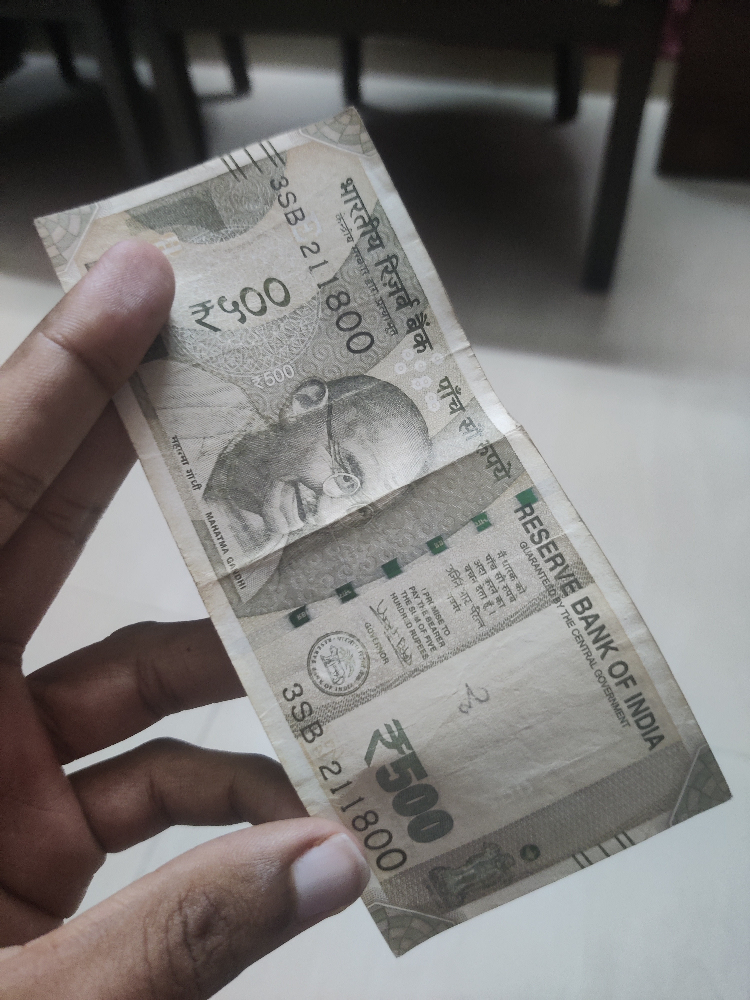

File Name: images\IMG_20211121_174747.jpg
Prediction: 500



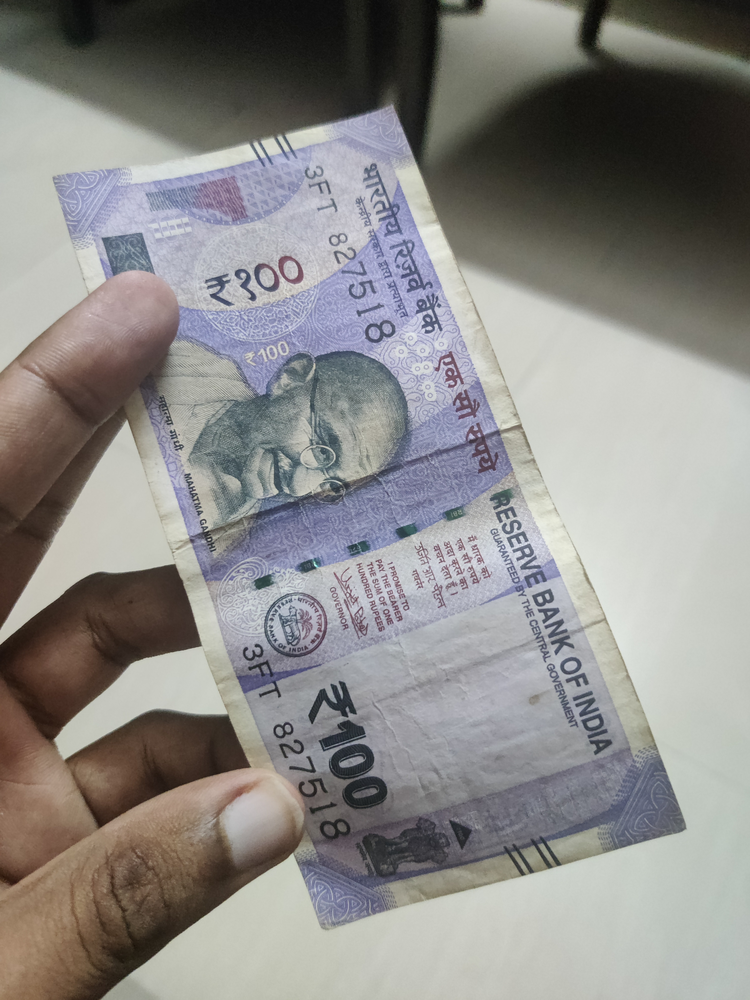

File Name: images\IMG_20211121_174756.jpg
Prediction: 100



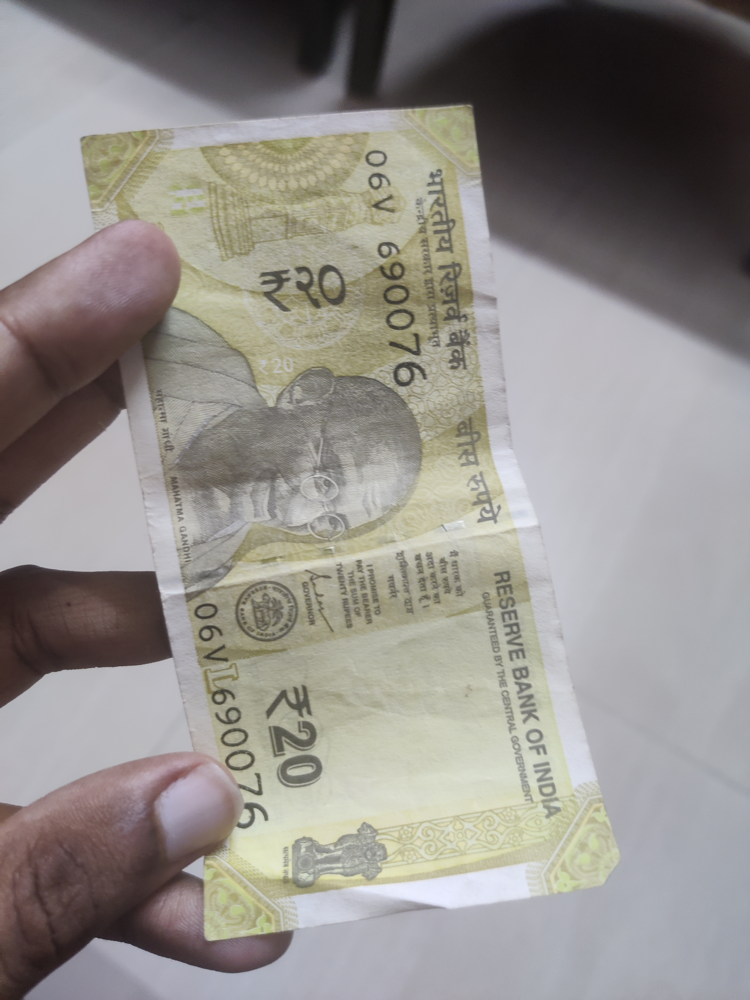

File Name: images\IMG_20211121_174820.jpg
Prediction: 20



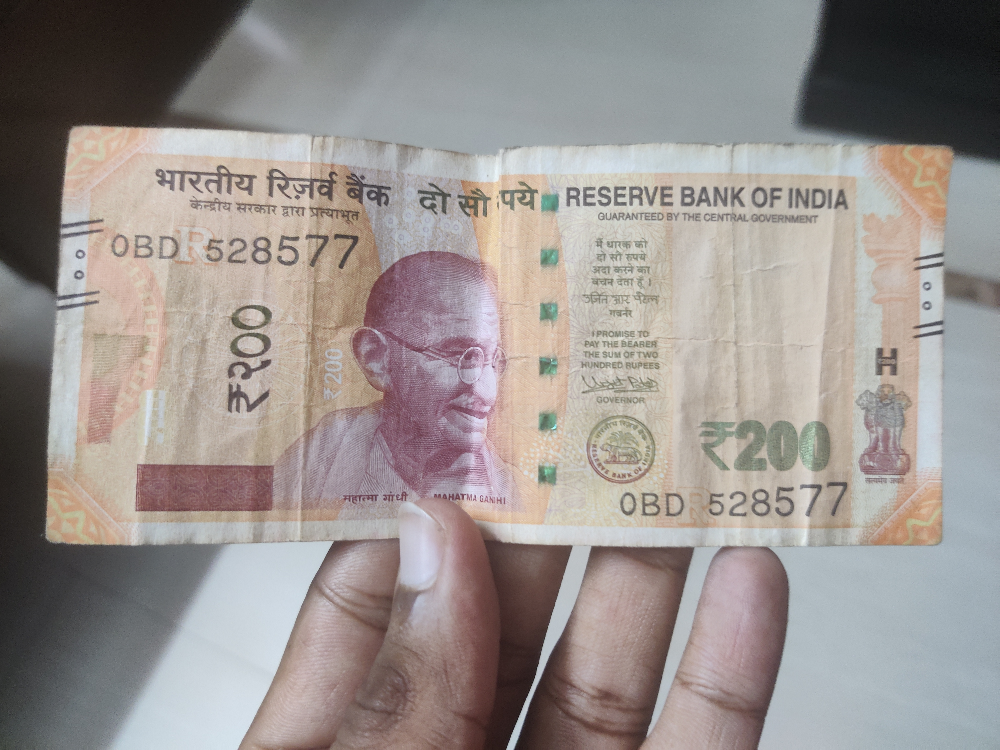

File Name: images\IMG_20211121_175449.jpg
Prediction: 200



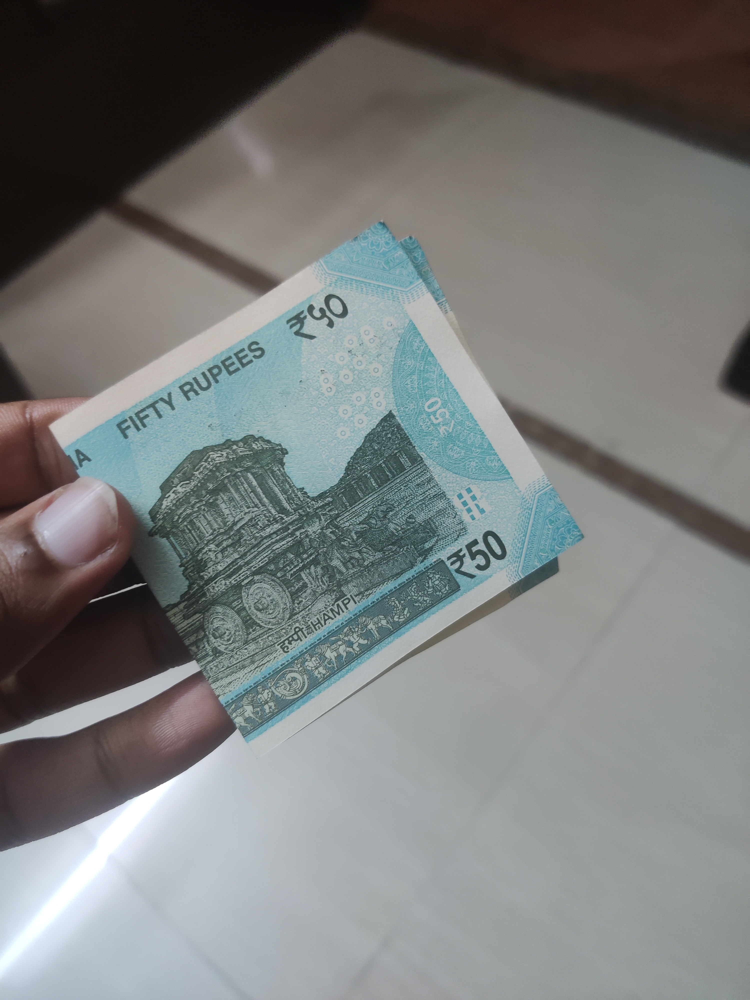

File Name: images\IMG_20211121_175500.jpg
Prediction: 50



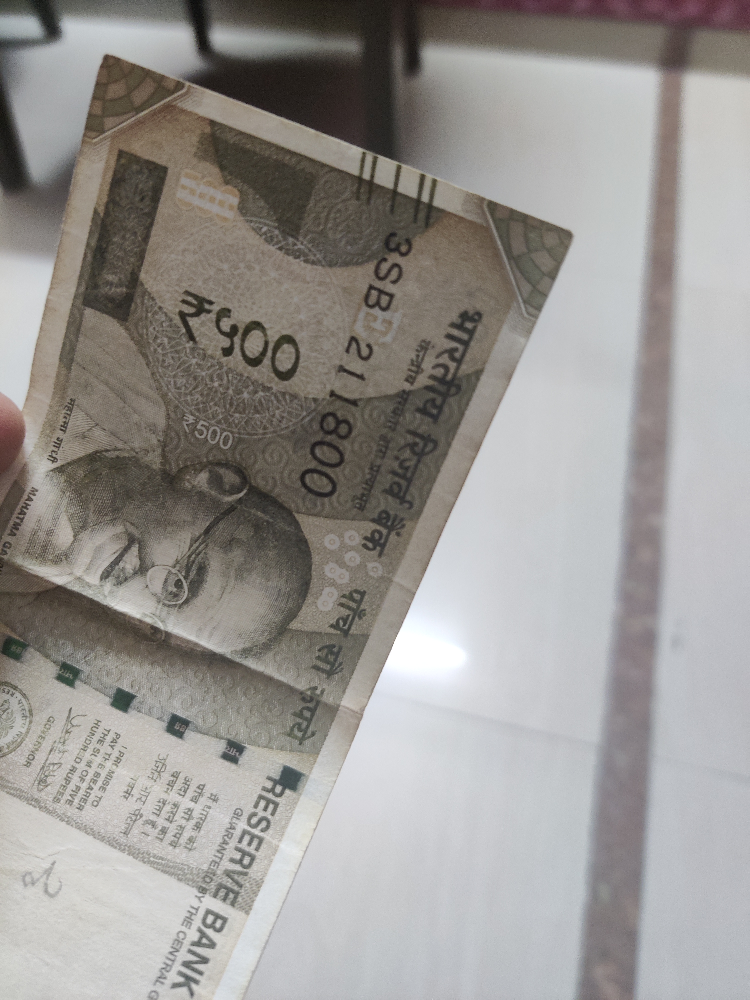

File Name: images\IMG_20211121_230112.jpg
Prediction: 500



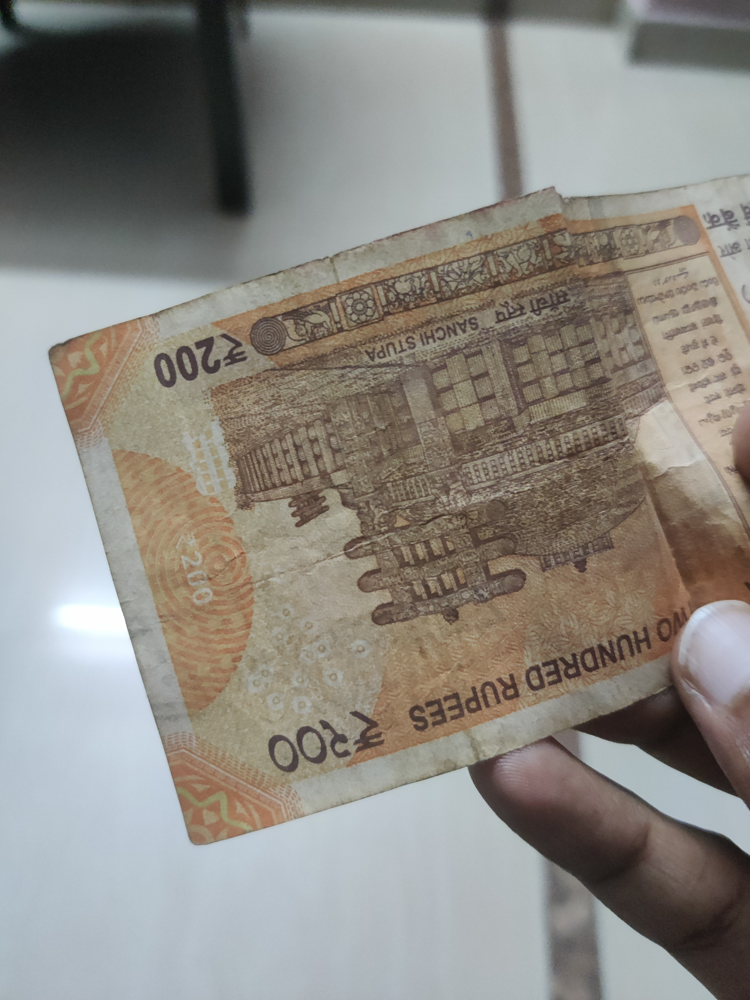

File Name: images\IMG_20211121_230151.jpg
Prediction: 200



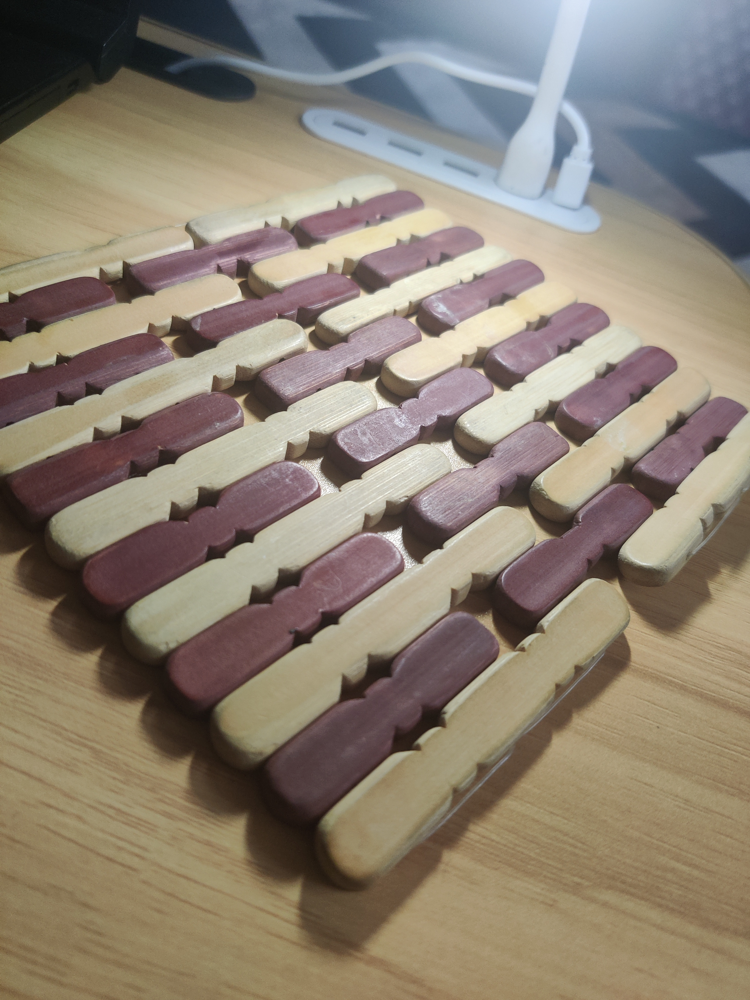

File Name: images\IMG_20211121_230424.jpg
Prediction: Background



In [10]:
filenames = test_generator.filenames
nb_samples = len(filenames)

# Returns arrays with probabilities of each class being the answer
predict = model.predict(test_generator,steps = 11, verbose=1)

# correct, incorrect =0,0 
for index, x in enumerate(filenames):
#   if x.split('\\')[1].split('__')[0] == label_map[np.argmax(predict[index])]:
    # correct += 1                                                                                
#     img = Image.open('test-temp\\' + x)
#     img.show() 
    
    display(Image(filename='test-temp\\' + x,width=250, height=250))

    print("File Name:",x)
    print("Prediction:",label_map[np.argmax(predict[index])])
    print()


#   else:
    # incorrect += 1
    # print(str(incorrect) + " " + x + " " + label_map[np.argmax(predict[index])])
# print(correct, incorrect)